# Week 2 - Torque-Free Motion

Week 2 explores the dynamics of single and dual rigid body systems under torque-free conditions, a critical scenario in spacecraft dynamics when no external torques act on the system. The module examines large-scale tumbling motions through the use of **polhode plots**, which visualize the angular velocity motion in the body frame. Analytical rate solutions are derived for both axi-symmetric and general spacecraft shapes, providing insights into how shape and mass distribution affect motion.

The module concludes with an analysis of the **dual-spinner dynamical system**, a practical example of how gyroscopic effects can be leveraged to stabilize a principal axis spin. This is particularly relevant for spacecraft with spinning components like reaction wheels or flywheels, where stability is key to maintaining attitude control.

Understanding torque-free motion is essential for characterizing the natural dynamics of spacecraft, especially during phases where control torques are intentionally minimized or unavailable (e.g., during thruster-free coasting or detumbling).

<ins>**Learning Objectives**</ins>

- Predict and determine torque-free motion equilibria and their associated stabilities
- Describe the torque-free motion of different rigid bodies in space
- Develop equations of motion for rigid bodies with multiple spinning components
- Apply static stability conditions for dual-spinner configurations

---

In [1]:
import numpy as np
import numexpr as ne
import plotly.graph_objects as go

# 2.1) Torque Free Single Rigid Body

Torque-free motion describes the behavior of a rigid body when no external torques act upon it. This concept is critical in spacecraft dynamics, where conservation principles like angular momentum and energy govern the system's behavior.

## 2.1.1 - An introduction to Torque Free Motion (pre-cursor to Polhode Plots)

**<ins>Angular Momentum Conservation</ins>**


<ins>Preliminary Note: Use of Principal Axes</ins>

Before delving into angular momentum conservation, we note that equations involving angular momentum become more manageable when expressed in the **principal axes frame**. In this frame:

- The **inertia tensor $\mathbf{I}$** is diagonal:
  $$
  \mathbf{I} = \begin{bmatrix} 
  I_1 & 0 & 0 \\ 
  0 & I_2 & 0 \\ 
  0 & 0 & I_3 
  \end{bmatrix}
  $$

- The angular momentum components in the **body frame** are decoupled:
  $$
  \vec{\mathbf{H}} = \mathbf{I} \vec{\boldsymbol{\omega}} = \begin{bmatrix}
  I_1 \omega_1 \\ 
  I_2 \omega_2 \\ 
  I_3 \omega_3
  \end{bmatrix}.
  $$

We will adopt the principal axes representation to simplify our analysis.

---

**<ins>Angular Momentum Conservation</ins>**

- For a rigid body in **torque-free motion**, the angular momentum vector $\vec{\mathbf{H}}$ remains **constant in the inertial frame**:
  $$
  \dot{\vec{\mathbf{H}}} = \vec{\mathbf{L}} = 0
  $$

- In the **body-fixed frame**, however, the components of $\vec{\mathbf{H}}$ ($H_1$, $H_2$, $H_3$) vary over time because the body rotates. Despite this variation, the **magnitude** of $\vec{\mathbf{H}}$ remains constant:
  $$
  H = |\vec{\mathbf{H}}| = \sqrt{H_1^2 + H_2^2 + H_3^2}.
  $$

- We can express the magnitude of $\vec{\mathbf{H}}$ in terms of the dot product:
  $$
  H^2 = \vec{\mathbf{H}}^T \vec{\mathbf{H}},
  $$
  where $\vec{\mathbf{H}}^T \vec{\mathbf{H}}$ represents the squared magnitude of the angular momentum vector. This **mathematical equivalence** justifies the shorthand notation $H^2$.

---

**<ins>Momentum Sphere</ins>**

- The conservation of angular momentum implies that $\vec{\mathbf{H}}$ traces out a sphere in **inertial space**, called the **momentum sphere**:
  $$
  \boxed{H^2 = H_1^2 + H_2^2 + H_3^2 = \text{constant}}
  $$

---

**<ins>Physical Interpretation</ins>**

- **In the inertial frame**, the angular momentum vector $\vec{\mathbf{H}}$ remains fixed because no external torques act on the body.  
- **In the body frame**, due to the rigid body's rotation, $\vec{\mathbf{H}}$ precesses, but its magnitude is conserved.  

This precession is critical for understanding the body's dynamic behavior in torque-free motion.

---

**<ins>Kinetic Energy Conservation</ins>**

- Recall that the **rotational kinetic energy** of a rigid body is given by:
  $$
  T = \frac{1}{2} \vec{\boldsymbol{\omega}}^T \mathbf{I} \vec{\boldsymbol{\omega}}
  $$
  where:
  - $\vec{\boldsymbol{\omega}}$ is the angular velocity vector.
  - $\mathbf{I}$ is the inertia tensor.

- In general, $\mathbf{I}$ is a 3x3 symmetric matrix with off-diagonal terms, representing the coupling between different rotational axes:
  $$
  \mathbf{I} = \begin{bmatrix}
  I_{xx} & I_{xy} & I_{xz} \\
  I_{xy} & I_{yy} & I_{yz} \\
  I_{xz} & I_{yz} & I_{zz}
  \end{bmatrix}.
  $$

- By choosing the **principal axes frame** of the rigid body, the inertia tensor becomes diagonal:
  $$
  \mathbf{I} = \begin{bmatrix} 
  I_1 & 0 & 0 \\ 
  0 & I_2 & 0 \\ 
  0 & 0 & I_3 
  \end{bmatrix},
  $$
  where $I_1$, $I_2$, and $I_3$ are the **principal moments of inertia**.

- Substituting this diagonal form into the kinetic energy formula, we get:
  $$
  \boxed{T = \frac{1}{2} \left( I_1 \omega_1^2 + I_2 \omega_2^2 + I_3 \omega_3^2 \right)}
  $$

---

## 2.1.2 - Momentum/Energy Surfaces

- In torque-free rigid body dynamics, two fundamental surfaces describe the motion:
  - The **Kinetic Energy Ellipsoid**, which represents the total rotational kinetic energy of the body.
  - The **Momentum Sphere**, which represents the conservation of angular momentum in the body frame.

- These surfaces intersect because:
  1. The momentum sphere is defined by a constant angular momentum magnitude, $|\mathbf{H}|^2 = H_1^2 + H_2^2 + H_3^2$.
  2. The kinetic energy ellipsoid is defined by the rotational energy:
     $$
     T = \frac{1}{2}\left(\frac{H_1^2}{I_1} + \frac{H_2^2}{I_2} + \frac{H_3^2}{I_3}\right).
     $$
  3. Both are quadratic surfaces in the angular momentum components $H_1, H_2, H_3$, ensuring intersection due to their inherent symmetry.

- Thus, the intersection of these surfaces represents the physically permissible angular momentum states that satisfy both conservation laws.

**<ins>Momentum Sphere</ins>**

- The **momentum magnitude constraint** arises from the conservation of angular momentum:
  $$
  H^2 = H_1^2 + H_2^2 + H_3^2 = \text{constant}.
  $$
  - This equation defines a **sphere** in the $H_1$-$H_2$-$H_3$ space, known as the **momentum sphere**.

**<ins>Energy Ellipsoid</ins>**

- The **kinetic energy constraint** is given by:
  $$
  T = \frac{1}{2} \left( I_1 \omega_1^2 + I_2 \omega_2^2 + I_3 \omega_3^2 \right).
  $$
  Substituting $H_1$, $H_2$, $H_3$ into this equation, we get:
  $$
  \frac{H_1^2}{2 I_1 T} + \frac{H_2^2}{2 I_2 T} + \frac{H_3^2}{2 I_3 T} = 1.
  $$
- The constraint is normalized to $1$ by dividing the equation through by the conserved kinetic energy $T$. This ensures that the contributions of $H_1$, $H_2$, and $H_3$ are scaled relative to $T$, simplifying the equation to match the form of an ellipsoid:
  $$
  \frac{x^2}{a^2} + \frac{y^2}{b^2} + \frac{z^2}{c^2} = 1,
  $$
  where the semi-axes of the **energy ellipsoid** are:
  $$
  a = \sqrt{2 I_1 T}, \quad b = \sqrt{2 I_2 T}, \quad c = \sqrt{2 I_3 T}.
  $$

**<ins>Minimum Energy Case</ins>**

- At minimum energy, the ellipsoid is most tightly constrained along the $H_1$ axis.
- The momentum sphere intersects the ellipsoid at $H_1 = \pm H$ and $H_2 = H_3 = 0$.
- The corresponding kinetic energy is:
  $$
  T_\text{min} = \frac{H^2}{2 I_1}.
  $$
- This configuration corresponds to rotation purely about the principal axis with the highest moment of inertia, resulting in stable behavior.

**<ins>Intermediate Energy Case</ins>**

- At intermediate energy, the ellipsoid is less constrained along the $H_2$ axis.
- The intersection occurs at $H_2 = \pm H$ with $H_1$ and $H_3$ constrained to the ellipsoid.
- The kinetic energy is:
  $$
  T_\text{int} = \frac{H^2}{2 I_2}.
  $$
- This case relates to the **Tennis Racket Theorem**, which explains the instability of rotations about the intermediate principal axis. Small perturbations lead to a chaotic "flip" due to the lack of stability.

**<ins>Maximum Energy Case</ins>**

- At maximum energy, the ellipsoid is elongated along the $H_3$ axis.
- The momentum sphere intersects the ellipsoid at $H_3 = \pm H$ and $H_1 = H_2 = 0$.
- The kinetic energy is:
  $$
  T_\text{max} = \frac{H^2}{2 I_3}.
  $$
- This configuration corresponds to rotation about the principal axis with the smallest moment of inertia, a stable motion.

**<ins>Intersection of Momentum Sphere and Energy Ellipsoid</ins>**

- The angular velocity vector $\vec{\boldsymbol{\omega}}$ must satisfy both the **momentum sphere** and **energy ellipsoid** constraints simultaneously.

- This means $\vec{\boldsymbol{\omega}}$ lies on the **intersection** of these two surfaces.

- The trajectory traced by $\vec{\boldsymbol{\omega}}$ on the intersection of the momentum sphere and energy ellipsoid is called the **polhode curve**.

- In the **body-fixed frame**, the polhode curve describes the rotational dynamics of the rigid body.

**<ins>Physical Interpretation</ins>**

- The **momentum sphere** represents the constraint imposed by the conservation of angular momentum.  
- The **energy ellipsoid** represents the constraint imposed by the conservation of kinetic energy.  
- The **polhode curve** provides a visual representation of how angular velocity evolves within these constraints during torque-free motion.

- For a given angular momentum magnitude $H$, only a certain range of kinetic energies is possible.  
- Assuming the common ordering of the principal moments of inertia:
  $$
  I_1 \geq I_2 \geq I_3,
  $$
  the trajectory of the angular velocity vector $\vec{\boldsymbol{\omega}}(t)$ lies on the intersection of:
  - The **momentum sphere**, representing the conservation of angular momentum.
  - The **energy ellipsoid**, representing the conservation of kinetic energy.

- These combined constraints define the **polhode curve**, which visualizes the dynamics of torque-free motion in the body-fixed frame.
- The next 2 sub-sections are dedicated to plotting the polhode curves.

### 2.1.2.1 - A preliminary visualization of the Momentum Sphere and Energy Ellipsoid

In [2]:
''' Step 1: Defining Parameters and Calculating Angular Momentum Magnitude, H '''

# Define parameters
I1, I2, I3 = 10.0, 5.0, 2.0  # Principal moments of inertia (in kg·m²)

# Define angular velocity components (body rates)
omega_1 = 1.0  # rad/s
omega_2 = 0.8  # rad/s
omega_3 = 0.6  # rad/s

# Compute the magnitude of angular momentum
H1 = I1 * omega_1
H2 = I2 * omega_2
H3 = I3 * omega_3

# Total angular momentum magnitude, H
H = np.sqrt(H1**2 + H2**2 + H3**2)  
H

10.836973747315254

In [3]:
''' Step 2: Calculating Energy Levels and Ellipsoid Semi-Axes '''

# Calculate minimum, intermediate, and maximum energy levels
T_min = H**2 / (2 * I1)
T_int = H**2 / (2 * I2)
T_max = H**2 / (2 * I3)

# Set the current energy level to intermediate (you can adjust this to T_min, T_int, or T_max)
T = T_int

# Calculate semi-axes of the energy ellipsoid dynamically
a = np.sqrt(2 * I1 * T)
b = np.sqrt(2 * I2 * T)
c = np.sqrt(2 * I3 * T)

In [4]:
''' Step 3: Generate Grid and Calculate Sphere and Ellipsoid Equations '''

# Generate a fine grid of H1, H2, H3
num_points = 750
H1_vals = np.linspace(-H, H, num_points)
H2_vals = np.linspace(-H, H, num_points)
H3_vals = np.linspace(-H, H, num_points)

H1_grid, H2_grid, H3_grid = np.meshgrid(H1_vals, H2_vals, H3_vals, indexing='ij')

# Evaluate the momentum sphere equation over the grid
# sphere_eq provides a scalar field that indicates how close each grid point is
# to the surface of the sphere (0 for points on the surface, >0 outside, <0 inside).
sphere_eq = ne.evaluate("H1_grid**2 + H2_grid**2 + H3_grid**2 - H**2")
                       

# Evaluate the energy ellipsoid equation over the grid
# ellipsoid_eq provides a scalar field that indicates how close each grid point is
# to the surface of the ellipsoid (0 for points on the surface, >0 outside, <0 inside).
ellipsoid_eq = ne.evaluate("H1_grid**2 / a**2 + H2_grid**2 / b**2 + H3_grid**2 / c**2 - 1")

In [5]:
''' Step 4: Intersection Mask '''

# Find intersection points where both the sphere and ellipsoid equations are satisfied
# The condition (np.abs(sphere_eq) < tolerance) ensures points lie near the surface of the sphere
# The condition (np.abs(ellipsoid_eq) < tolerance) ensures points lie near the surface of the ellipsoid
# The logical AND (&) combines these conditions to find points that lie on both surfaces simultaneously,
# i.e., the intersection curve between the sphere and ellipsoid
tolerance = 0.02
intersection_mask = (np.abs(ellipsoid_eq) < tolerance) & (np.abs(sphere_eq) < tolerance)

x_curve = H1_grid[intersection_mask]
y_curve = H2_grid[intersection_mask]
z_curve = H3_grid[intersection_mask]

In [6]:
''' Step 5: Generate Sphere and Ellipsoid Surfaces for Plotting '''

# Create grid for sphere and ellipsoid
u = np.linspace(0, 2 * np.pi, 50)
v = np.linspace(0, np.pi, 50)
u_grid, v_grid = np.meshgrid(u, v)

# Momentum Sphere
x_sphere = H * np.sin(v_grid) * np.cos(u_grid)
y_sphere = H * np.sin(v_grid) * np.sin(u_grid)
z_sphere = H * np.cos(v_grid)

# Energy Ellipsoid
x_ellipsoid = a * np.sin(v_grid) * np.cos(u_grid)
y_ellipsoid = b * np.sin(v_grid) * np.sin(u_grid)
z_ellipsoid = c * np.cos(v_grid)

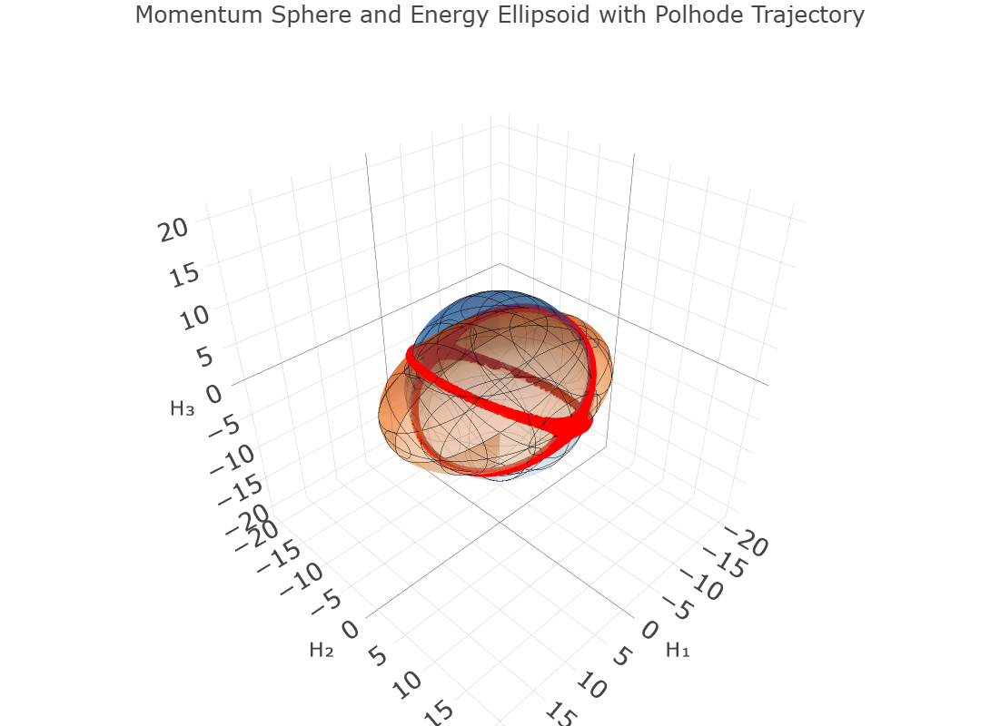

In [7]:
''' Step 6: Plotting '''

# Create plotly figure
fig = go.Figure()

# Add Momentum Sphere (Wireframe)
fig.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere,
                         opacity=0.5, 
                         colorscale='Blues', 
                         showscale=False,
                         name="Momentum Sphere",
                         contours={"x": {"show": True, "color": "black"},
                                   "y": {"show": True, "color": "black"},
                                   "z": {"show": True, "color": "black"}
                                  }
                        )
             )

# Add Energy Ellipsoid (Wireframe)
fig.add_trace(go.Surface(x=x_ellipsoid, y=y_ellipsoid, z=z_ellipsoid,
                         opacity=0.5, 
                         colorscale='Oranges', 
                         showscale=False,
                         name="Energy Ellipsoid",
                         contours={"x": {"show": True, "color": "black"},
                                   "y": {"show": True, "color": "black"},
                                   "z": {"show": True, "color": "black"}
                                  }
                        )
             )

# Add Polhode Curve
fig.add_trace(go.Scatter3d(x=x_curve, y=y_curve, z=z_curve,
                           mode='markers', 
                           marker=dict(color='red', size=5),
                           name="Polhode Trajectory"
                          )
             )

# Update the figure layout with presentation style
fig.update_layout(width=1000,
                  height=800,
                  template='presentation',
                  scene={"aspectmode": 'cube',
                         "xaxis": {"range": [-2*H, 2*H], "autorange": False, "title": "H₁"},
                         "yaxis": {"range": [-2*H, 2*H], "autorange": False, "title": "H₂"},
                         "zaxis": {"range": [-2*H, 2*H], "autorange": False, "title": "H₃"},
                        },
                  margin=dict(l=0, r=0, t=50, b=0),
                  title="Momentum Sphere and Energy Ellipsoid with Polhode Trajectory",
                 )

# Show the plot
fig.show()


### 2.1.2.2 - Polhode Plotter Function

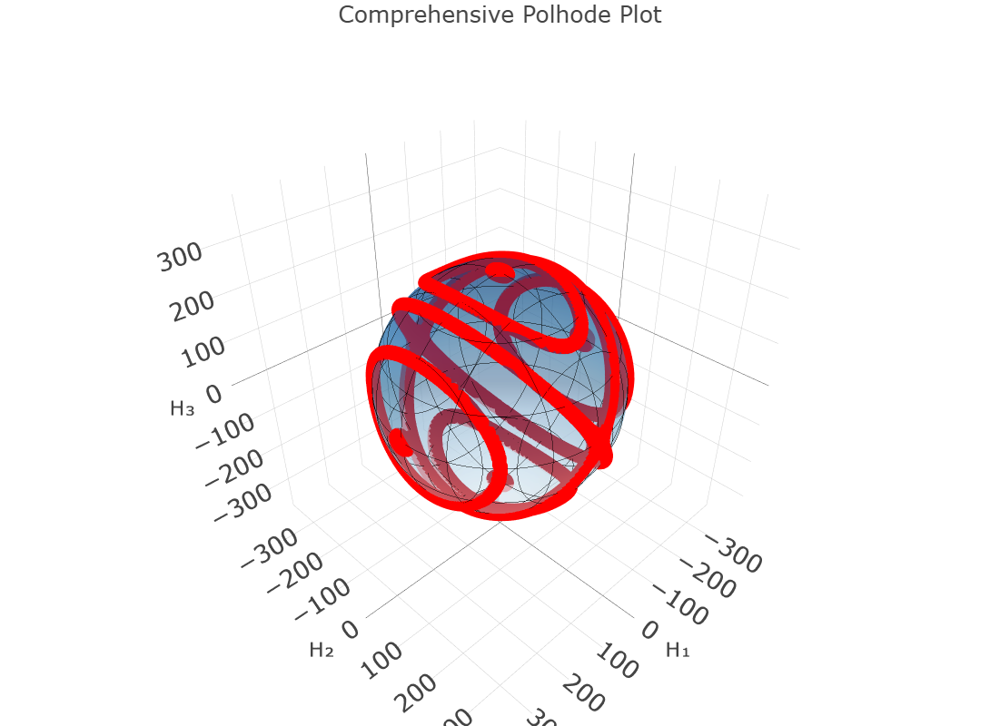

In [8]:
def polhode_plotter(I, omega):
    """
    Plot a comprehensive polhode plot with intersection lines for varying energy levels.
    
    Parameters:
    - I: List/Array of principal moments of inertia [I1, I2, I3].
    - omega: List/Array of body rates along the principal axes [omega_1, omega_2, omega_3].
    """
    # Unpack moments of inertia and body rates
    I1, I2, I3 = I
    omega_1, omega_2, omega_3 = omega

    
    # Compute angular momentum components and magnitude
    H1 = I1 * omega_1
    H2 = I2 * omega_2
    H3 = I3 * omega_3
    H = np.sqrt(H1**2 + H2**2 + H3**2)  # Total angular momentum magnitude
    
    # Calculate minimum, intermediate, and maximum energy levels
    T_min = H**2 / (2 * I1)
    T_int = H**2 / (2 * I2)
    T_max = H**2 / (2 * I3)
    
    # Define energy levels for plotting later
    energy_levels = [T_min,                      # Minimum energy
                     (T_min + T_int) / 2,        # Midpoint between T_min and T_int
                     T_int,                      # Intermediate energy level
                     (T_int + T_max) / 2,        # Midpoint between T_int and T_max
                     T_max                       # Maximum energy
                    ]
    
    # Initialize arrays for storing curves
    all_x_curves, all_y_curves, all_z_curves = [], [], []

    # Discretize theta and phi for the momentum sphere
    # - If all three principal moments of inertia (I1, I2, I3) are equal, the energy ellipsoid reduces to a perfect sphere.
    # - In this degenerate case, the entire momentum sphere is effectively the intersection, and the computation becomes redundant.
    # - To optimize performance, we use a significantly lower angular resolution (`num_angles = 40`) since the high resolution 
    #   would waste time computing the intersection for a self-intersecting sphere.
    # - For non-degenerate cases (I1 ≠ I2 ≠ I3), we retain a high resolution (`num_angles = 750`) for accurate intersection computation and to present the curves
    if np.isclose(I1, I2) and np.isclose(I2, I3):
        num_angles = 40  # Define lower angular resolution for the degenerate case
    else:
        num_angles = 750  # Define high angular resolution for general cases
    
    theta_vals = np.linspace(0, np.pi, num_angles)                # Polar angle
    phi_vals = np.linspace(0, 2 * np.pi, num_angles)              # Azimuthal angle
    theta_grid, phi_grid = np.meshgrid(theta_vals, phi_vals)

    # Compute Cartesian coordinates for the sphere
    H1_grid = H * np.sin(theta_grid) * np.cos(phi_grid)
    H2_grid = H * np.sin(theta_grid) * np.sin(phi_grid)
    H3_grid = H * np.cos(theta_grid)

    # Compute momentum sphere equation
    #sphere_eq = ne.evaluate("H1_grid**2 + H2_grid**2 + H3_grid**2 - H**2")

    # Loop over energy levels
    for T in energy_levels:
        # Calculate semi-axes of the energy ellipsoid
        a = np.sqrt(2 * I1 * T)
        b = np.sqrt(2 * I2 * T)
        c = np.sqrt(2 * I3 * T)

        # Compute energy ellipsoid equation
        ellipsoid_eq = ne.evaluate("H1_grid**2 / a**2 + H2_grid**2 / b**2 + H3_grid**2 / c**2 - 1")
        
        # Check for intersection points on the ellipsoid surface:
        # - The ellipsoid equation is satisfied when the value of `ellipsoid_eq` approaches 0.
        # - `np.abs(ellipsoid_eq) < tolerance` identifies points that are very close to the ellipsoid surface,
        #   within a small allowable margin (`tolerance`).
        # - Since the points are already constrained to lie on the momentum sphere (via spherical parameterization),
        #   this condition effectively finds points that intersect both the momentum sphere and the energy ellipsoid.
        tolerance = 0.002
        intersection_mask = (np.abs(ellipsoid_eq) < tolerance)
        
        # Extract intersection points
        x_curve = H1_grid[intersection_mask]
        y_curve = H2_grid[intersection_mask]
        z_curve = H3_grid[intersection_mask]

        # Store intersection curves
        all_x_curves.append(x_curve)
        all_y_curves.append(y_curve)
        all_z_curves.append(z_curve)

    # Create grid for visualization of momentum sphere
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    u_grid, v_grid = np.meshgrid(u, v)

    x_sphere = H * np.sin(v_grid) * np.cos(u_grid)
    y_sphere = H * np.sin(v_grid) * np.sin(u_grid)
    z_sphere = H * np.cos(v_grid)

    # Create figure
    fig = go.Figure()

    # Add momentum sphere
    fig.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere,
                             opacity=0.5, colorscale='Blues', showscale=False,
                             name="Momentum Sphere",
                             contours={"x": {"show": True, "color": "black"},
                                       "y": {"show": True, "color": "black"},
                                       "z": {"show": True, "color": "black"}
                                      }
                            )
                 )

    # Add polhode curves for each energy level
    for i in range(len(all_x_curves)):
        fig.add_trace(go.Scatter3d(x=all_x_curves[i].flatten(), y=all_y_curves[i].flatten(), z=all_z_curves[i].flatten(),
                                   mode='markers',
                                   line=dict(color='red', width=1),
                                   #name=f"Polhode Curve {i+1}"
                                  )
                     )

    # Update the figure layout
    fig.update_layout(width=1000,
                      height=800,
                      template='presentation',
                      scene={"aspectmode": 'cube',
                             "xaxis": {"range": [-1.5*H, 1.5*H], "autorange": False, "title": "H₁"},
                             "yaxis": {"range": [-1.5*H, 1.5*H], "autorange": False, "title": "H₂"},
                             "zaxis": {"range": [-1.5*H, 1.5*H], "autorange": False, "title": "H₃"},
                            },
                      margin=dict(l=0, r=0, t=50, b=0),
                      title="Comprehensive Polhode Plot",
                      showlegend=False
                     )

    # Show the plot
    fig.show()

# Define principal moments of inertia
I = [300, 500, 700]

# Define body rates along principal axes
omega = [0.5, 0.3, 0.2] 

# Call the function
polhode_plotter(I, omega)

## 2.1.3 - Analytical Torque-Free Motion

### 2.1.3.1 - Axi-Symmetric Case

**Torque-Free Motion for an Axisymmetric Body**

- Assume no external torque is acting on the body, i.e., $\mathbf{T} = 0$.
- For an axisymmetric rigid body, the principal moments of inertia satisfy $I_T = I_{11} = I_{22}$, with $I_{33}$ representing the symmetry axis.

---

**Equations of Motion**

Euler's equations for the axisymmetric case are:

$$
I_T \dot{\omega}_1 = -(I_{33} - I_T)\omega_2 \omega_3
$$

$$
I_T \dot{\omega}_2 = (I_{33} - I_T)\omega_3 \omega_1
$$

$$
I_{33} \dot{\omega}_3 = 0
$$

From the third equation, $\dot{\omega}_3 = 0$, which implies that $\omega_3$ is constant:

$$
\omega_3(t) = \omega_3(0)
$$

The first two equations describe the dynamics of $\omega_1$ and $\omega_2$, which are interdependent due to the torque-free interaction.

---

**Step-by-Step Derivation**

1. **Taking the time derivative of the first equation:**

   Start with:

   $$
   I_T \dot{\omega}_1 = -(I_{33} - I_T)\omega_2 \omega_3
   $$

   Take the time derivative and with the knowledge that $\omega_3$ is a constant, the equation becomes:

   $$
   I_T \ddot{\omega}_1 = -(I_{33} - I_T)\dot{\omega}_2 \omega_3
   $$


2. **Expressing $\dot{\omega}_2$ in terms of $I_T$, $I_{33}$, $\omega_3$ and $\omega_1$:**

   From the second equation:

   $$
   I_T \dot{\omega}_2 = (I_{33} - I_T)\omega_3 \omega_1
   $$

   Solving for $\dot{\omega}_2$ (essentially moving $\dot{\omega}_2$ to the LHS):

   $$
   \dot{\omega}_2 = \frac{(I_{33} - I_T)\omega_3 \omega_1}{I_T}
   $$

3. **Substitute $\dot{\omega}_2$ into the expression for $\ddot{\omega}_1$:**

   Substituting $\dot{\omega}_2$ into the equation for $\ddot{\omega}_1$:

   $$
   I_T \ddot{\omega}_1 = -(I_{33} - I_T)\left(\frac{(I_{33} - I_T)\omega_3 \omega_1}{I_T}\right)\omega_3
   $$

   Simplify:

   $$
   I_T \ddot{\omega}_1 = -\frac{(I_{33} - I_T)^2 \omega_3^2 \omega_1}{I_T}
   $$

   Divide through by $I_T$:

   $$
   \ddot{\omega}_1 + \left(\frac{I_{33}}{I_T} - 1\right)^2 \omega_3^2 \omega_1 = 0
   $$

---

**Result for $\omega_1$:**

This is a second-order differential equation for $\omega_1$, describing simple harmonic motion:

$$
\ddot{\omega}_1 + k \omega_1 = 0
$$

where:

$$
k = \left(\frac{I_{33}}{I_T} - 1\right)^2 \omega_3^2
$$

---

**Repeating for $\omega_2$:**

A similar process applies to $\omega_2$:

Start with:

$$
I_T \dot{\omega}_2 = (I_{33} - I_T)\omega_3 \omega_1
$$

Taking the time derivative:

$$
I_T \ddot{\omega}_2 = (I_{33} - I_T)\dot{\omega}_1 \omega_3
$$

Expressing $\dot{\omega}_1$ in terms of $I_T$, $I_{33}$, $\omega_2$ and $\omega_1$:

$$
\dot{\omega}_1 = -\frac{(I_{33} - I_T)\omega_3 \omega_2}{I_T}
$$

Substitute this into $\ddot{\omega}_2$:

$$
I_T \ddot{\omega}_2 = -\frac{(I_{33} - I_T)^2 \omega_3^2 \omega_2}{I_T}
$$

Divide through by $I_T$:

$$
\ddot{\omega}_2 + \left(\frac{I_{33}}{I_T} - 1\right)^2 \omega_3^2 \omega_2 = 0
$$

---

**Final Equations for $\omega_1$ and $\omega_2$:**

Both $\omega_1$ and $\omega_2$ satisfy independent harmonic oscillator equations:

$$
\ddot{\omega}_1 + \left(\frac{I_{33}}{I_T} - 1\right)^2 \omega_3^2 \omega_1 = 0
$$

$$
\ddot{\omega}_2 + \left(\frac{I_{33}}{I_T} - 1\right)^2 \omega_3^2 \omega_2 = 0
$$

---

**Takeaway:**

The system simplifies to two independent harmonic oscillators for $\omega_1$ and $\omega_2$, while $\omega_3$ remains constant. This is consistent with the axisymmetric geometry of torque-free motion.
(Investigate why the solution, shown in the next cell, is of that form!)

**Solutions**

The solutions to the harmonic oscillator equations for $\omega_1$ and $\omega_2$ are sinusoidal:

$$
\omega_1(t) = A_1 \cos(\omega_p t) + B_1 \sin(\omega_p t)
$$

$$
\omega_2(t) = A_2 \cos(\omega_p t) + B_2 \sin(\omega_p t)
$$

$$
\omega_3(t) = \omega_{30}
$$

where the precession frequency $\omega_p$ is given by:

$$
\omega_p = \left(\frac{I_{33}}{I_T} - 1\right) \omega_3
$$

**Key Observations**

- $\omega_3$ remains constant throughout the motion.
- $\omega_1$ and $\omega_2$ exhibit sinusoidal behavior, oscillating between positive and negative values.

**Physical Interpretation**

The motion can be visualized using the **momentum sphere** and **energy ellipsoid**:
- The momentum sphere is defined by the constant angular momentum magnitude:

$$
H^2 = I_1^2 \omega_1^2 + I_2^2 \omega_2^2 + I_3^2 \omega_3^2
$$

- The energy ellipsoid is defined by the total rotational kinetic energy:

$$
T = \frac{1}{2}(I_1 \omega_1^2 + I_2 \omega_2^2 + I_3 \omega_3^2)
$$

The intersections of these two surfaces define the **polhode curves**, along which the motion occurs. The precession direction is determined by the sign of $\omega_p$:
- If $I_{33} > I_T$, precession is positive.
- If $I_{33} < I_T$, precession is negative.

**Sinusoidal Dynamics**

The sinusoidal nature of $\omega_1$ and $\omega_2$ reflects the energy exchange between these components while conserving total energy. Graphically:
- $\omega_1$ and $\omega_2$ oscillate sinusoidally with the same frequency $\omega_p$, but with phase differences.
- $\omega_3$ remains constant, indicating no energy exchange with the $b_3$ axis.

**Applications**

- This analysis is critical for understanding the behavior of axisymmetric bodies in torque-free motion, such as spin-stabilized spacecraft.
- The sinusoidal solutions provide insights into stability and control requirements for real-world applications.

**Summary**

In the axisymmetric case, the simplicity of the equations allows for an exact analytical solution. The motion is characterized by constant $\omega_3$ and sinusoidal $\omega_1$ and $\omega_2$, with dynamics analogous to a spring-mass oscillator. The intersections of the momentum sphere and energy ellipsoid determine the polhode curves along which the body rotates.

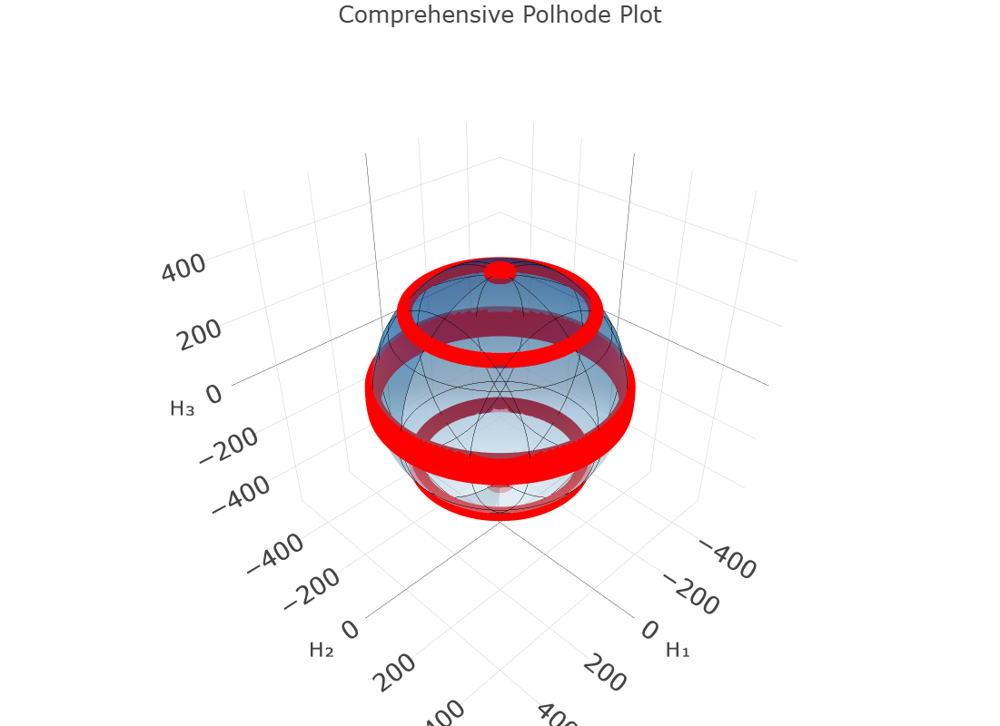

In [9]:
# Define principal moments of inertia (axisymmetric case), I1 = I2 = I_T, I3 distinct
I = [500, 500, 700]  

# Define body rates along principal axes (some Initial angular velocity components)
omega = [0.1, 0.2, 0.5]  

# Call the function
polhode_plotter(I, omega)

**Axisymmetric Case - Polhode Plot Interpretation**

- The above polhode plot is characteristic of **axisymmetric objects**, where $I_1 = I_2 = I_T$. These objects can be:
  - **Prolate shapes** (elongated): Examples include pencils, rocket bodies, and fuselages. These have a larger moment of inertia along the symmetry axis ($I_3 > I_T$).
  - **Oblate shapes** (flattened): Examples include flywheels, discs, or flat satellites. These have a smaller moment of inertia along the symmetry axis ($I_3 < I_T$).

- For prolate objects:
  - The polhode curve reflects oscillatory motion of $\omega_1$ and $\omega_2$ about the symmetry axis, while $\omega_3$ remains constant.
  - This type of motion is typical of spinning elongated objects like rockets or pencils.

- For oblate objects:
  - The polhode curve will exhibit different dynamics due to the smaller moment of inertia along the symmetry axis.

### 2.1.3.2 - General Inertia Case

**<ins>Momentum and Kinetic Energy Conservation for Torque-Free Motion</ins>**

The torque-free motion of a rigid body is governed by two fundamental conservation principles, which act as constraints on the system's dynamics:

- **Angular Momentum Magnitude Conservation**:
  $$
  H^2 = I_1^2 \omega_1^2 + I_2^2 \omega_2^2 + I_3^2 \omega_3^2
  $$
  This equation represents the conservation of angular momentum. It describes an ellipsoid in the angular velocity space, where $H$ is the conserved angular momentum magnitude, and $I_1, I_2, I_3$ are the principal moments of inertia.

- **Rotational Kinetic Energy Conservation**:
  $$
  2T = I_1 \omega_1^2 + I_2 \omega_2^2 + I_3 \omega_3^2
  $$
  This equation represents the conservation of rotational kinetic energy. It describes another ellipsoid in angular velocity space, with moments of inertia as coefficients and $T$ as the conserved kinetic energy.

**<ins>The General Inertia Case</ins>**

The general inertia case refers to the motion of a rigid body with three distinct principal moments of inertia: $I_1 \neq I_2 \neq I_3$. Unlike symmetric cases where moments of inertia are equal or two are identical, this scenario introduces complex dynamics due to the lack of symmetry in the body's inertia properties. The angular velocity components $\omega_1, \omega_2, \omega_3$ evolve along the intersection of the momentum sphere (from $H^2$) and the kinetic energy ellipsoid (from $2T$). 

These constraints, when solved simultaneously, provide relationships between the angular velocity components $\omega_1$, $\omega_2$, and $\omega_3$. This analysis is essential for studying torque-free motion in irregularly shaped bodies, such as spacecraft or asymmetrical rigid bodies, where their rotational dynamics depend on the interplay between angular momentum and kinetic energy constraints.

**_Step 1: Write out the Constraint Equations_**

The motion of a torque-free rigid body is governed by two key conservation principles, which act as constraints in the system:

1. **Angular Momentum Magnitude Conservation**:
   $$
   H^2 = I_1^2 \omega_1^2 + I_2^2 \omega_2^2 + I_3^2 \omega_3^2
   $$
   This equation represents the conservation of angular momentum, describing an ellipsoid in the angular velocity space with squared moments of inertia.

2. **Rotational Kinetic Energy Conservation**:
   $$
   2T = I_1 \omega_1^2 + I_2 \omega_2^2 + I_3 \omega_3^2
   $$
   This equation represents the conservation of rotational kinetic energy, describing another ellipsoid in the angular velocity space with moments of inertia as coefficients.

These equations are used as constraints to relate the angular velocity components $\omega_1$, $\omega_2$, and $\omega_3$. The next steps involve solving these two equations simultaneously to derive relationships between the angular velocity components.

---

**_Step 2: Express $\omega_3^2$ in Terms of $\omega_1^2$ and $\omega_2^2$_**

To find $\omega_3^2$, we use both the angular momentum conservation equation and the rotational kinetic energy equation, allowing for two different forms of $\omega_3^2$. This will enable simultaneous working of the constraint equations.

1. **From Angular Momentum Conservation**:
   $$
   H^2 = I_1^2 \omega_1^2 + I_2^2 \omega_2^2 + I_3^2 \omega_3^2
   $$
   Solve for $\omega_3^2$:
   $$
   \omega_3^2 = \frac{H^2 - I_1^2 \omega_1^2 - I_2^2 \omega_2^2}{I_3^2}
   $$

2. **From Rotational Kinetic Energy Conservation**:
   $$
   2T = I_1 \omega_1^2 + I_2 \omega_2^2 + I_3 \omega_3^2
   $$
   Solve for $\omega_3^2$:
   $$
   \omega_3^2 = \frac{2T - I_1 \omega_1^2 - I_2 \omega_2^2}{I_3}
   $$

These two expressions for $\omega_3^2$ allow us to work with the angular momentum and rotational kinetic energy constraints simultaneously to derive relationships between the angular velocity components.

---

**_Step 3: Equate the Two Forms of $\omega_3^2$ to Find $\omega_2^2$ in Terms of $\omega_1^2$_**

1. Start with the two expressions for $\omega_3^2$:
   - From angular momentum conservation:
     $$
     \omega_3^2 = \frac{H^2 - I_1^2 \omega_1^2 - I_2^2 \omega_2^2}{I_3^2}
     $$
   - From rotational kinetic energy conservation:
     $$
     \omega_3^2 = \frac{2T - I_1 \omega_1^2 - I_2 \omega_2^2}{I_3}
     $$

2. Equate the two expressions for $\omega_3^2$:
   $$
   \frac{H^2 - I_1^2 \omega_1^2 - I_2^2 \omega_2^2}{I_3^2} = \frac{2T - I_1 \omega_1^2 - I_2 \omega_2^2}{I_3}
   $$

3. Multiply through by $I_3^2$ to eliminate the denominators:
   $$
   H^2 - I_1^2 \omega_1^2 - I_2^2 \omega_2^2 = I_3 \left(2T - I_1 \omega_1^2 - I_2 \omega_2^2\right)
   $$

4. Expand the terms on the right-hand side:
   $$
   H^2 - I_1^2 \omega_1^2 - I_2^2 \omega_2^2 = 2I_3 T - I_3 I_1 \omega_1^2 - I_3 I_2 \omega_2^2
   $$

5. Rearrange to isolate terms involving $\omega_2^2$:
   $$
   \left(I_2^2 - I_3 I_2\right) \omega_2^2 = 2I_3 T - H^2 + \left(I_1^2 - I_3 I_1\right) \omega_1^2
   $$

6. Simplify the coefficient of $\omega_2^2$:
   $$
   I_2^2 - I_3 I_2 = I_2 \left(I_2 - I_3\right)
   $$

   Substitute this back:
   $$
   \omega_2^2 = \frac{2I_3 T - H^2}{I_2 (I_3 - I_2)} - \frac{I_1 (I_3 - I_1)}{I_2 (I_3 - I_2)} \omega_1^2
   $$

This final expression provides $\omega_2^2$ in terms of $\omega_1^2$ and the conserved quantities $H^2$ and $T$.

---

**_Step 4: Repeat Steps 1-3_**

Repeat the above process to derive $\omega_3^2$:
$$
\omega_3^2 = \frac{2I_1 T - H^2}{I_3 (I_1 - I_3)} - \frac{I_1 (I_2 - I_1)}{I_3 (I_1 - I_3)} \omega_1^2
$$

---

By solving the constraint equations simultaneously, we can express the angular rates ($\omega_1$, $\omega_2$, $\omega_3$) in terms of the conserved quantities ($H$, $T$), the principal moments of inertia ($I_1$, $I_2$, $I_3$), and a single known angular rate ($\omega_i$). 

Since there are three body rates corresponding to the three principal axes, and two constraint equations (angular momentum and kinetic energy conservation), the system is underdetermined, leaving one angular rate free to be specified. This results in **three pairs of equations** for the angular rates, where:

- $\omega_2^2$ and $\omega_3^2$ are expressed in terms of $\omega_1^2$,
- $\omega_1^2$ and $\omega_3^2$ are expressed in terms of $\omega_2^2$,
- $\omega_1^2$ and $\omega_2^2$ are expressed in terms of $\omega_3^2$.

This yields a total of six permutations or ways of representing the body rates. The three pairs of equations shown are a direct result of this structure.

These equations are critical for understanding the interdependence of the angular rates in torque-free motion and are particularly useful for analyzing the rotational dynamics of a rigid body.

So in summary, steps 1-3 must be repeated for a total of 6 times to yield the following equations:

- Pair 1 (function of $\omega_1$),
$$
\omega_2^2 = \frac{2I_3 T - H^2}{I_2 (I_3 - I_2)} - \frac{I_1 (I_3 - I_1)}{I_2 (I_3 - I_2)} \omega_1^2
$$
$$
\omega_3^2 = \frac{2I_2 T - H^2}{I_3 (I_2 - I_3)} - \frac{I_1 (I_2 - I_1)}{I_3 (I_2 - I_3)} \omega_1^2
$$

- Pair 2 (function of $\omega_2$),
$$
\omega_1^2 = \frac{2I_3 T - H^2}{I_1 (I_3 - I_1)} - \frac{I_2 (I_3 - I_2)}{I_1 (I_3 - I_1)} \omega_2^2
$$
$$
\omega_3^2 = \frac{H^2 - 2I_1 T}{I_3 (I_1 - I_3)} - \frac{I_2 (I_1 - I_2)}{I_3 (I_1 - I_3)} \omega_2^2
$$

- Pair 3 (function of $\omega_3$),
$$
\omega_1^2 = \frac{2I_2 T - H^2}{I_1 (I_2 - I_1)} - \frac{I_3 (I_2 - I_3)}{I_1 (I_2 - I_1)} \omega_3^2
$$
$$
\omega_2^2 = \frac{H^2 - 2I_1 T}{I_2 (I_1 - I_2)} - \frac{I_3 (I_1 - I_3)}{I_2 (I_1 - I_2)} \omega_3^2
$$

**<ins>Angular Accelerations from Euler's Torque-Free Equations</ins>**

The starting point is the Euler Rotational Equations of Motion for torque-free motion:
$$
I_1 \dot{\omega}_1 = -(I_3 - I_2) \omega_2 \omega_3
$$
$$
I_2 \dot{\omega}_2 = -(I_1 - I_3) \omega_3 \omega_1
$$
$$
I_3 \dot{\omega}_3 = -(I_2 - I_1) \omega_1 \omega_2
$$

Taking the time derivative, the angular accelerations can be expressed as:
$$
\ddot{\omega}_1 = \frac{I_2 - I_3}{I_1} \left(\dot{\omega_2} \omega_3 + \omega_2 \dot{\omega}_3\right)
$$
$$
\ddot{\omega}_2 = \frac{I_3 - I_1}{I_2} \left(\dot{\omega_3} \omega_1 + \omega_3 \dot{\omega}_1\right)
$$
$$
\ddot{\omega}_3 = \frac{I_1 - I_2}{I_3} \left(\dot{\omega_1} \omega_2 + \omega_1 \dot{\omega}_2\right)
$$

From Euler's Rotational EOM we can find the equations for $\dot{\omega_{1}}, \dot{\omega_{2}}, \dot{\omega_{3}}$ and substitute them into the 2nd Order ODE:
$$
\ddot{\omega}_1 = \frac{I_2 - I_3}{I_1} \left(\frac{I_1 - I_2}{I_3} \omega_1 \omega_2^2 + \frac{I_3 - I_1}{I_2} \omega_1 \omega_3^2\right)
$$
$$
\ddot{\omega}_2 = \frac{I_3 - I_1}{I_2} \left(\frac{I_1 - I_2}{I_3} \omega_2 \omega_1^2 + \frac{I_2 - I_3}{I_1} \omega_2 \omega_3^2\right)
$$
$$
\ddot{\omega}_3 = \frac{I_1 - I_2}{I_3} \left(\frac{I_3 - I_1}{I_2} \omega_3 \omega_1^2 + \frac{I_2 - I_3}{I_1} \omega_3 \omega_2^2\right)
$$

These equations provide the second-order differential forms for the angular accelerations in terms of the principal moments of inertia and angular rates.

**<ins>Connection Between Angular Accelerations and Duffing Equations</ins>**

Building on the second-order differential equations for angular accelerations derived from Euler's torque-free equations, we utilize the conservation laws of rotational energy and angular momentum to express the angular velocities in terms of the conserved quantities $H^2$, $2T$, and one of the angular velocity components. This allows us to substitute $\omega_i^2$ for $i = 1, 2, 3$ in terms of the other angular velocity components:

For instance:
$$
\omega_2^2 = \frac{2I_3 T - H^2}{I_2 (I_3 - I_2)} - \frac{I_1 (I_3 - I_1)}{I_2 (I_3 - I_2)} \omega_1^2
$$
$$
\omega_3^2 = \frac{2I_1 T - H^2}{I_3 (I_1 - I_3)} - \frac{I_1 (I_2 - I_1)}{I_3 (I_1 - I_3)} \omega_1^2
$$

These expressions, when substituted into the second-order differential equations for $\ddot{\omega}_i$, yield nonlinear differential equations involving cubic terms of $\omega_i$. These equations take the form:
$$
\ddot{\omega}_i + A_i \omega_i + B_i \omega_i^3 = 0, \quad \text{for } i = 1, 2, 3
$$

This is the **homogeneous, undamped Duffing equation**, a fundamental equation in nonlinear dynamics. The cubic stiffness term, $B_i \omega_i^3$, accounts for the inherent nonlinearity of the system due to the torque-free rotational dynamics and the coupling between the angular velocities.

Thus, the torque-free rotational motion of a rigid body is governed by Duffing equations, highlighting the rich nonlinear dynamics of such systems. This exact differential form connects angular accelerations directly to nonlinear mechanical oscillations.

**<ins>Spring Constants in Torque-Free Motion</ins>**

The equations:
$$
\ddot{\omega}_i + A_i \omega_i + B_i \omega_i^3 = 0, \quad \text{for } i = 1, 2, 3
$$
represent three **uncoupled nonlinear oscillators**, where the coefficients $A_i$ and $B_i$ uniquely depend on the moments of inertia ($I_1, I_2, I_3$), the rotational energy $T$, and the angular momentum $H$. These coefficients are summarized as:

| $i$ | $A_i$                                                                       | $B_i$                                             |
|-----|-----------------------------------------------------------------------------|---------------------------------------------------|
| 1   | $\frac{(I_1 - I_2)(2I_3 T - H^2) + (I_1 - I_3)(2I_2 T - H^2)}{I_1 I_2 I_3}$ | $\frac{2(I_1 - I_2)(I_1 - I_3)}{I_2 I_3}$         |
| 2   | $\frac{(I_2 - I_3)(2I_1 T - H^2) + (I_2 - I_1)(2I_3 T - H^2)}{I_1 I_2 I_3}$ | $\frac{2(I_2 - I_3)(I_2 - I_1)}{I_1 I_3}$         |
| 3   | $\frac{(I_3 - I_1)(2I_2 T - H^2) + (I_3 - I_2)(2I_1 T - H^2)}{I_1 I_2 I_3}$ | $\frac{2(I_3 - I_1)(I_3 - I_2)}{I_1 I_2}$         |

While these oscillators are **uncoupled**, they are **not independent**, as the six constants depend on the initial values of the system's inertia, energy, and momentum constants. These dependencies ensure the oscillators are uniquely determined for a given torque-free rotational motion.

In [7]:
import sympy as sp
from sympy import sin, Eq, Function, symbols, init_printing

from IPython.display import display, Math

# Initialize pretty printing for MathJax
init_printing(use_latex="mathjax")

# Enable MathJax for LaTeX formatting in Jupyter Notebook
sp.init_printing(use_latex='mathjax')

# Define parameters and the time-dependent function theta
m, a, l, It, Ia, Omega, t = symbols('m a l I_t I_a \\Omega t')  # Parameters with LaTeX-compatible symbols
theta = Function('\\theta')(t)  # Define theta(t) with LaTeX symbol

# Define first and second derivatives of theta
theta_dot = theta.diff(t)
theta_ddot = theta_dot.diff(t)

# Define the equation of motion (EOM)
EOM = Eq(theta_ddot + ((It - Ia) / It) * ((Omega**2) / 2) * sin(2 * theta), 0)

# Display the equation of motion in LaTeX
display(EOM)


  2                    2                                
 d               \Omega ⋅(-Iₐ + Iₜ)⋅sin(2⋅\theta(t))    
───(\theta(t)) + ─────────────────────────────────── = 0
  2                              2⋅Iₜ                   
dt                                                      

### 2.1.3.3 - General Free Rotation

### 2.1.3.4 - Axi-Symmetric Coning Motion

# 2.2) Dual Spin Spacecraft